## Zadanie - klasyczna detekcja obiektów

Celem tego zadania jest własnoręczne zbudowanie, debugowanie i przetestowanie przez Ciebie prostego pipeline'u do rozpoznawania obiektów opartego o klasyczne metody przetwarzania obrazów.

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

from enum import Enum
from typing import Any, List

Dany jest obraz wzorcowy `calib` przedstawiający leki w organizerze.
Twoim zadaniem będzie zaproponowanie algorytmu detekcji, który przyjmie obraz wejściowy i wykryje na nim obiekty - poszczególne tabletki, zwracając informację o ich położeniach i gatunkach.
Reprezentacja tej informacji jest dowolna: pary koordynat (X,Y) środka obiektu, bounding boksy (XYHW), czy kontury - istotne jest jedynie, by liczba detekcji możliwie dobrze zgadzała się ze stanem faktycznym.

Zadanie ma charakter projektowy i nie jest podzielone na szczegółowo opisane podpunkty, ponieważ można do niego podejść na różne sposoby (czytaj dalej).

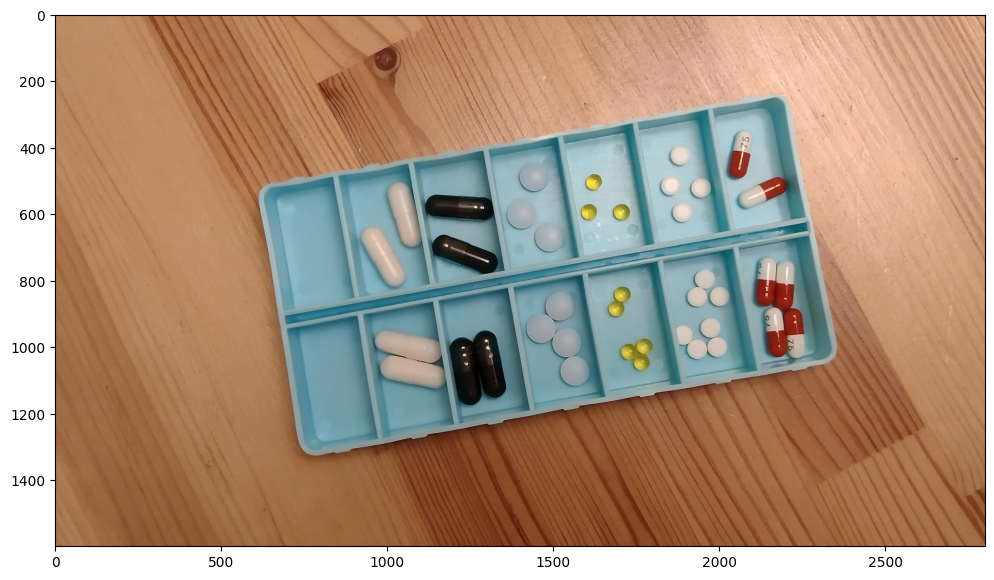

In [2]:
calib = cv2.imread("./Lab5_dane/calib.png")
plt.subplots(1, 1, figsize=(12,8))[1].imshow(calib[..., ::-1]);

Występuje 6 klas obiektów; patrząc na organizer od lewej:

In [3]:
class PillType(Enum):
    PROBIO = 1    # duże białe kapsułki
    CARBON = 2    # duże czarne kapsułki
    KETO = 3      # niebieskie tabletki
    ESPU = 4      # małe żółte kapsułki
    BIOX = 5      # małe białe tabletki
    LINE = 6      # czerwono-białe kapsułki (klasa trudna - realizacja opcjonalna)

Górny rząd zawiera łatwiejsze przykłady pojedynczych instancji, podczas gdy w rzędzie dolnym obiekty stykają się ze sobą, co utrudnia identyfikację.
Jak widzisz, nie wszystkie klasy są tak samo "wdzięczne" do wykrycia.
Nie próbuj zatem robić wszystkiego naraz - rekomendowane jest podejście sekwencyjne: najpierw zaimplementuj algorytm detekcji dla jednej klasy, przetestuj go i napraw, rozszerz o możliwość detekcji stykających się obiektów (_jak to zrobić?_), a dopiero potem podejmij kolejną klasę.

Wykorzystaj narzędzia poznane do tej pory (konwersje przestrzeni barw, binaryzację, detekcję krawędzi, etc.) by sprowadzić obraz do takiej postaci, w której detekcję interesujących obiektów będzie można wykonać za pomocą zwyczajnej ekstrakcji komponentów spójności - [`cv2.findContours`](https://docs.opencv.org/4.x/d3/dc0/group__imgproc__shape.html#gadf1ad6a0b82947fa1fe3c3d497f260e0).
Wspomóż się operacjami morfologicznymi jeśli to potrzebne, i nie wahaj się stosować jakichkolwiek narzędzi jakie znajdziesz -
wszystkie chwyty są dozwolone, za wyjątkiem stosowania metod MLowych.

W zależności od wybranej reprezentacji wykrytych obiektów, zaimplementuj metodę wizualizacji wyników.

Nie usuwaj notebooka, w którym będziesz debugować algorytm!
Przyda się podczas rozmowy, jeśli zajdzie konieczność wyjaśnienia dlaczego twój algorytm popełnia błędy - możliwość pokazania krok po kroku wykonywanych operacji będzie istotna.

### Rozwiązanie:

In [4]:
from collections import Counter
%reload_ext autoreload
%autoreload 2
import sys
import importlib

sys.path.append('./')

from methods import *

# Refresh the imported modules
importlib.reload(sys.modules['methods'])

<module 'methods' from '/Users/filipstrozik/Documents/studies/IISEM/image-and-video-processing/Laboratorium 5-20241025/methods.py'>

In [5]:
class Pill:
    """Output of object detection, represents a single instance"""
    def __init__(self, pill_type: PillType, location: Any):
        self.type = pill_type
        self.location = location

In [6]:
def detect_objects(image: np.ndarray, **kwargs) -> List[Pill]:

    def create_pills_from_contours(contours, pill_type):
        detected_pills: List[Pill] = []

        for contour in contours:
            location = contour
            detected_pills.append(Pill(pill_type, location))
        
        return detected_pills

    all_pills = []
    show = False
    carbon = create_pills_from_contours(
        black_pill_binarizer(image, show), PillType.CARBON
    )

    espu = create_pills_from_contours(
        yellow_pills_binarizer(image, show), PillType.ESPU
    )

    keto = create_pills_from_contours(blue_pills_binarizer(image, show), PillType.KETO)

    probio = create_pills_from_contours(
        big_white_pills_binarize(image, show), PillType.PROBIO
    )

    biox = create_pills_from_contours(
        small_white_pills_binarize(image, show), PillType.BIOX
    )

    all_pills = carbon + espu + keto + probio + biox

    return all_pills

In [7]:
COLORMAP = {
    # RGB colorspace
    PillType.PROBIO: (255, 255, 255),
    PillType.CARBON: (0, 0, 0),
    PillType.KETO: (0, 0, 255),
    PillType.ESPU: (255, 255, 0),
    PillType.BIOX: (255, 0, 255),
    PillType.LINE: (255, 0, 0),
}

def display_objects(image: np.ndarray, objects: List[Pill]) -> None:
    pill_counter = Counter(pill.type for pill in objects)
    for pill_type, count in pill_counter.items():
        print(f"{pill_type.name}: {count}")

    image = image.copy()

    for obj in objects:
        color = COLORMAP[obj.type]
        cv2.drawContours(image, [obj.location], -1, color, 2)

    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title("Detected Pills with Color Mapping")
    plt.axis("off")
    plt.show()

CARBON: 4
ESPU: 8
KETO: 7
PROBIO: 4
BIOX: 11


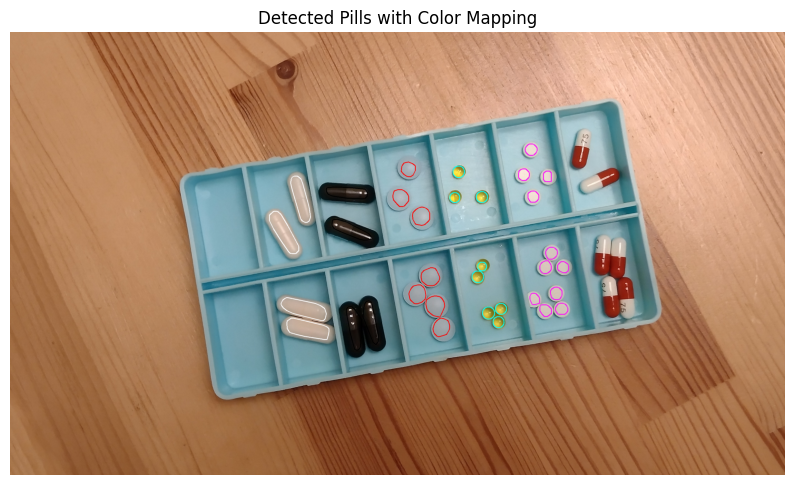

In [8]:
found = detect_objects(calib)
display_objects(calib, found)

### Test

Przetestuj swój algorytm na obrazie testowym `test.png` (lub `test_line.png`, jeśli podejmujesz się detekcji klasy LINE).
Gdzie pojawiają się problemy, skąd się biorą?
Jak można im zaradzić?

CARBON: 6
ESPU: 8
KETO: 7
PROBIO: 5
BIOX: 8


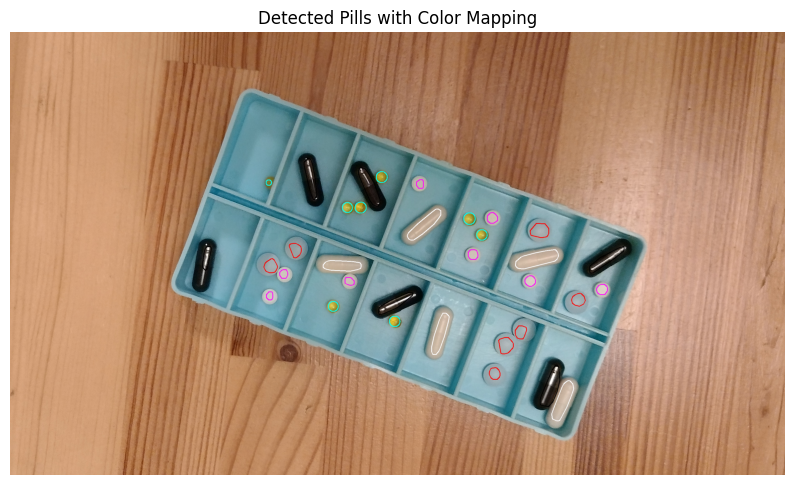

In [9]:
test = cv2.imread("./Lab5_dane/test.png")
all_test_pills = detect_objects(test)
display_objects(test, all_test_pills)

---

### Zadanie dodatkowe - dla chętnych

Cel: zliczenie wystąpień leków w poszczególnych komórkach organizera.

Wykorzystaj transformację Hougha do wykrycia linii oddzielających komórki organizera.
Dowolną poznaną metodą oblicz środki wykrytych obiektów.
Połącz obie informacje by określić zawartość każdej z komórek.

Wynik tej operacji powinien mieć formę struktury logicznej, pozwalającej na odpowiadanie na pytania np. "czy w 3 komórce dolnego rzędu są dwie sztuki `biox`?";
żadne szczegóły implementacyjne tej struktury nie są narzucone.

Jak poprzednio, zacznij od obrazu `calib`, a gotowy algorytm przetestuj na obrazach testowych.

In [10]:
def rhotheta2xy(line):
    # konwersja parametrów prostej w układzie rho-theta do odcinka w układzie kartezjańskim
    # wynik można użyć jako argumenty funkcji cv2.line
    rho, theta = line[0]
    a = np.cos(theta)
    b = np.sin(theta)
    x0 = a * rho
    y0 = b * rho
    x1 = int(x0 + 5000 * (-b))
    y1 = int(y0 + 5000 * (a))
    x2 = int(x0 - 5000 * (-b))
    y2 = int(y0 - 5000 * (a))
    return x1, y1, x2, y2

In [20]:
def scale_contour(contour, scale):
    M = cv2.moments(contour)
    if M["m00"] == 0:
        return contour
    cx = int(M["m10"] / M["m00"])
    cy = int(M["m01"] / M["m00"])

    contour = contour - [cx, cy]

    contour = contour * scale

    contour = contour + [cx, cy]

    return contour.astype(np.int32)

In [25]:
def find_cells(img, show=False):
    pillbox = img.copy()
    figsize = (5, 5)
    if show:
        plt.subplots(1, 1, figsize=figsize)[1].imshow(pillbox[..., ::-1])

    hue_lower_band = 90
    hue_upper_band = 110

    hsv = cv2.cvtColor(pillbox, cv2.COLOR_BGR2HSV)

    pillbox_hue = hsv[..., 0]

    mask = cv2.inRange(pillbox_hue, hue_lower_band, hue_upper_band)
    if show:
        plt.subplots(1, 1, figsize=figsize)[1].imshow(mask, cmap="gray")

    contours, _ = cv2.findContours(
        mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE
    )

    largest_contour = max(contours, key=cv2.contourArea)
    hull = cv2.convexHull(largest_contour)

    mask = np.zeros_like(mask)
    cv2.drawContours(mask, [hull], -1, 255, -1)

    pillbox = cv2.bitwise_and(pillbox, pillbox, mask=mask)

    if show:
        plt.subplots(1, 1, figsize=figsize)[1].imshow(pillbox[..., ::-1])

    blur = cv2.GaussianBlur(pillbox, (5, 5), 0)
    edges = cv2.Canny(blur, 100, 100)
    if show:
        plt.subplots(1, 1, figsize=figsize)[1].imshow(edges, cmap="gray")

    rho = 0.40
    theta = 0.01
    threshold = 80

    black = np.zeros_like(pillbox)
    lines = cv2.HoughLines(edges, rho=rho, theta=theta, threshold=threshold)

    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = rhotheta2xy(line)
            cv2.line(black, (x1, y1), (x2, y2), (0, 255, 0), 2)

    if show:
        plt.subplots(1, 1, figsize=figsize)[1].imshow(black)
        plt.show()

    gray_lines = cv2.cvtColor(black, cv2.COLOR_BGR2GRAY)
    if show:
        plt.subplots(1, 1, figsize=figsize)[1].imshow(gray_lines, cmap="gray")
    _, binary_lines = cv2.threshold(gray_lines, 1, 255, cv2.THRESH_BINARY)
    if show:
        plt.subplots(1, 1, figsize=figsize)[1].imshow(binary_lines, cmap="gray")

    kernel = np.ones((9, 9), np.uint8)
    dilated_lines = cv2.dilate(binary_lines, kernel, iterations=1)
    if show:
        plt.subplots(1, 1, figsize=figsize)[1].imshow(dilated_lines, cmap="gray")

    dilated_lines = cv2.bitwise_not(dilated_lines)

    if show:
        plt.subplots(1, 1, figsize=figsize)[1].imshow(dilated_lines, cmap="gray")

    dilated_lines = cv2.bitwise_and(dilated_lines, dilated_lines, mask=mask)

    contours, _ = cv2.findContours(
        dilated_lines, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE
    )

    rectangles_image = pillbox.copy()
    cv2.drawContours(rectangles_image, contours, -1, (0, 255, 0), 2)

    if show:
        plt.subplots(1, 1, figsize=figsize)[1].imshow(rectangles_image[..., ::-1])

    filtered_contours = [c for c in contours if 40_000 < cv2.contourArea(c) < 80_000]

    rectangles_image = pillbox.copy()
    cv2.drawContours(rectangles_image, filtered_contours, -1, (0, 255, 0), 2)

    if show:
        plt.subplots(1, 1, figsize=figsize)[1].imshow(rectangles_image[..., ::-1])

    # scale contours
    scale = 1.2
    scaled_contours = [scale_contour(c, scale) for c in filtered_contours]

    if show:
        rectangles_image = pillbox.copy()
        cv2.drawContours(rectangles_image, scaled_contours, -1, (0, 255, 0), 2)
        plt.subplots(1, 1, figsize=figsize)[1].imshow(rectangles_image[..., ::-1])

    return scaled_contours

In [26]:
def is_point_inside_contour(point, contour):
    return cv2.pointPolygonTest(contour, point, False) >= 0

def get_pill_center(contour):
    M = cv2.moments(contour)
    if M["m00"] != 0:
        cX = int(M["m10"] / M["m00"])
        cY = int(M["m01"] / M["m00"])
    else:
        cX, cY = 0, 0
    return (cX, cY)

def count_pills_in_contours(pills, filtered_contours):
    pills_in_contours = {i: {pill_type: 0 for pill_type in PillType} for i in range(len(filtered_contours))}
    
    for pill in pills:
        pill_center = get_pill_center(pill.location)
        for i, contour in enumerate(filtered_contours):
            if is_point_inside_contour(pill_center, contour):
                pills_in_contours[i][pill.type] += 1
                break
    
    return pills_in_contours


def display_pills_in_contours(img):
    cells = find_cells(img)
    found = detect_objects(img)
    pills_in_contours = count_pills_in_contours(found, cells)
    for i, contour in enumerate(cells):
        image_copy = img.copy()
        cv2.drawContours(image_copy, [contour], -1, (0, 255, 0), 2)
        plt.figure(figsize=(10, 10))
        plt.imshow(cv2.cvtColor(image_copy, cv2.COLOR_BGR2RGB))
        plt.title(f"Contour {i}")
        plt.axis("off")
        plt.show()

        print(f"Contour {i} contains:")
        for pill_type, count in pills_in_contours[i].items():
            print(f"  {pill_type.name}: {count}")

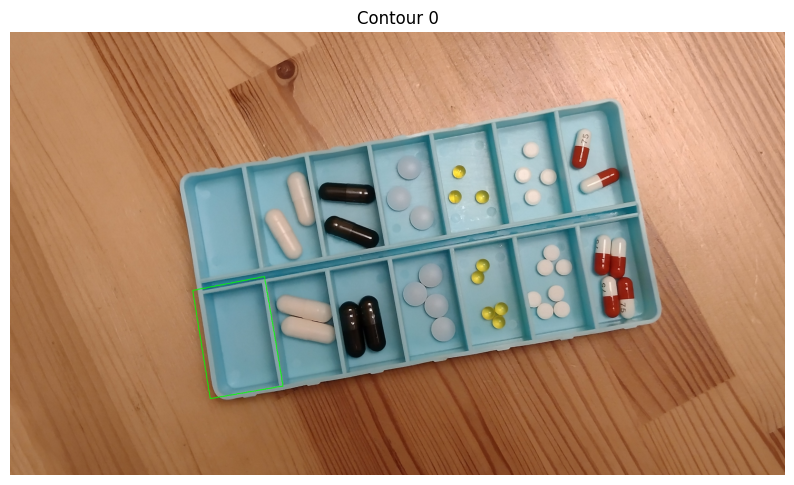

Contour 0 contains:
  PROBIO: 0
  CARBON: 0
  KETO: 0
  ESPU: 0
  BIOX: 0
  LINE: 0


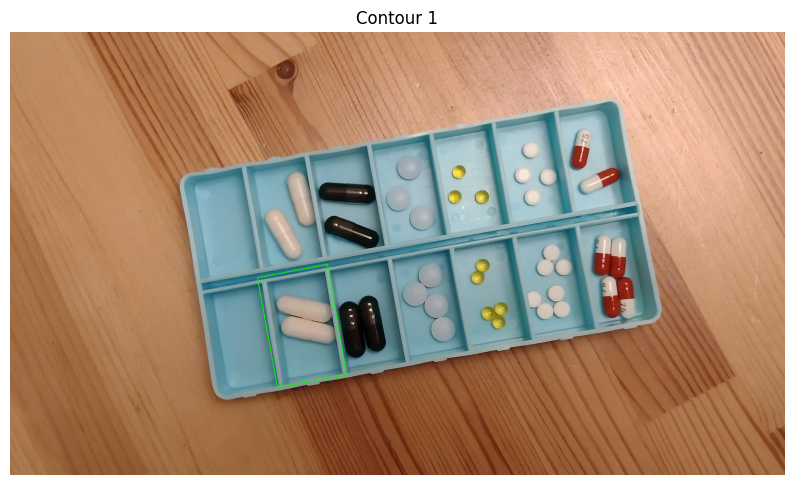

Contour 1 contains:
  PROBIO: 2
  CARBON: 0
  KETO: 0
  ESPU: 0
  BIOX: 0
  LINE: 0


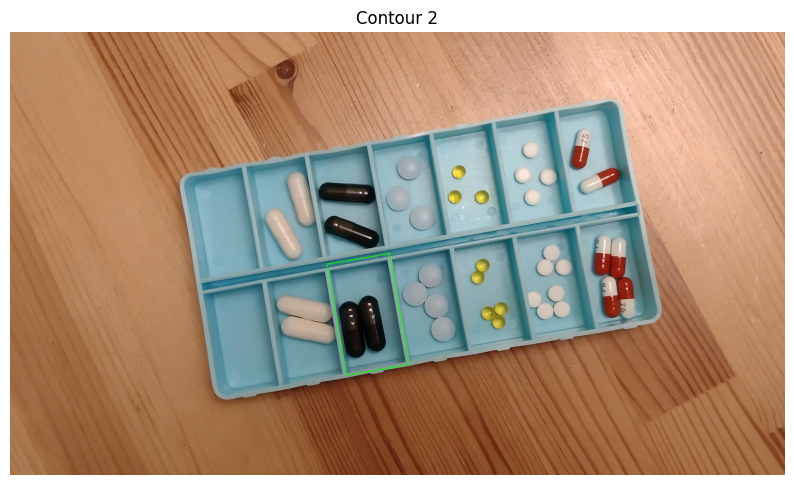

Contour 2 contains:
  PROBIO: 0
  CARBON: 2
  KETO: 0
  ESPU: 0
  BIOX: 0
  LINE: 0


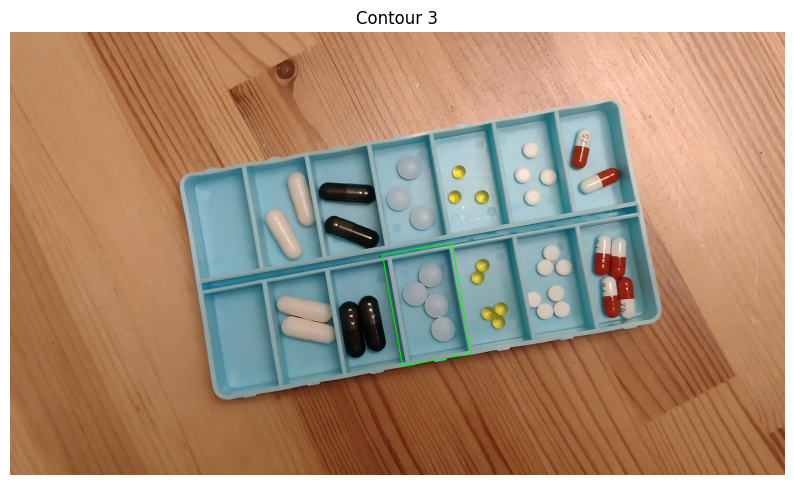

Contour 3 contains:
  PROBIO: 0
  CARBON: 0
  KETO: 4
  ESPU: 0
  BIOX: 0
  LINE: 0


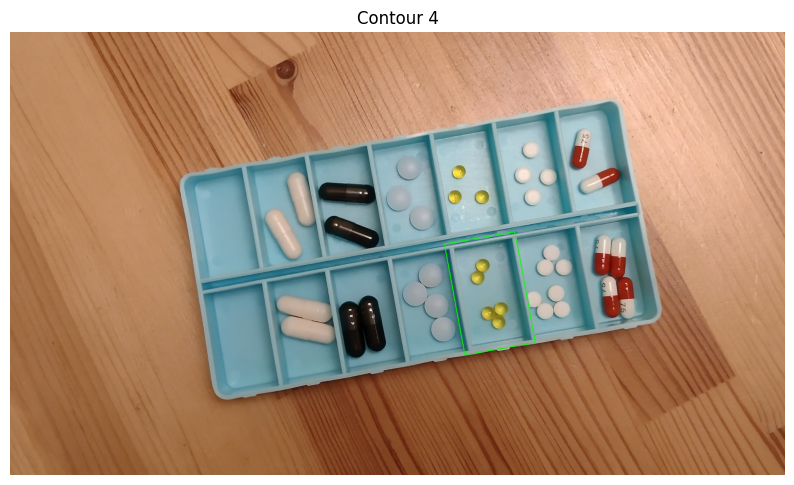

Contour 4 contains:
  PROBIO: 0
  CARBON: 0
  KETO: 0
  ESPU: 5
  BIOX: 0
  LINE: 0


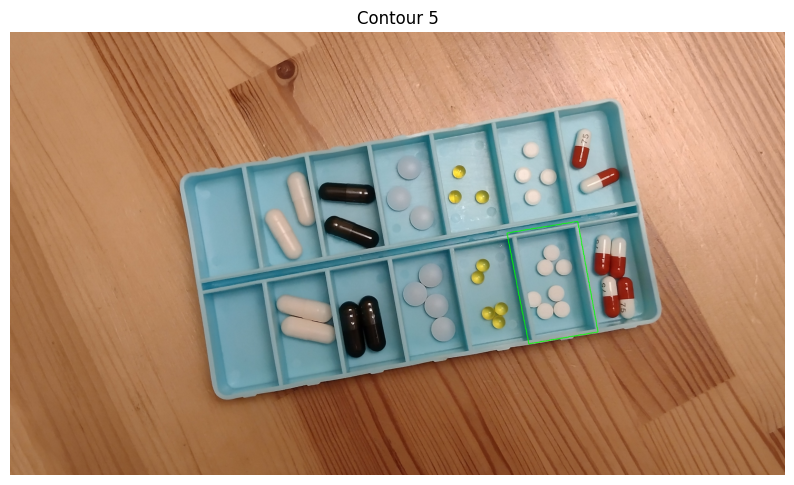

Contour 5 contains:
  PROBIO: 0
  CARBON: 0
  KETO: 0
  ESPU: 0
  BIOX: 7
  LINE: 0


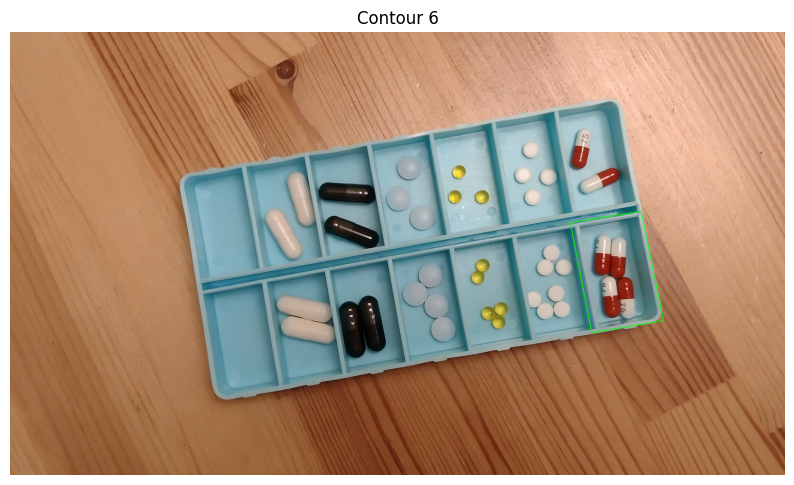

Contour 6 contains:
  PROBIO: 0
  CARBON: 0
  KETO: 0
  ESPU: 0
  BIOX: 0
  LINE: 0


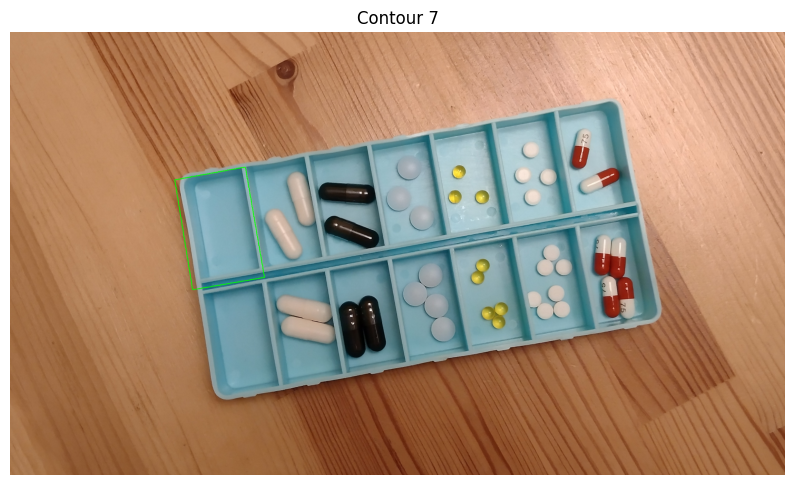

Contour 7 contains:
  PROBIO: 0
  CARBON: 0
  KETO: 0
  ESPU: 0
  BIOX: 0
  LINE: 0


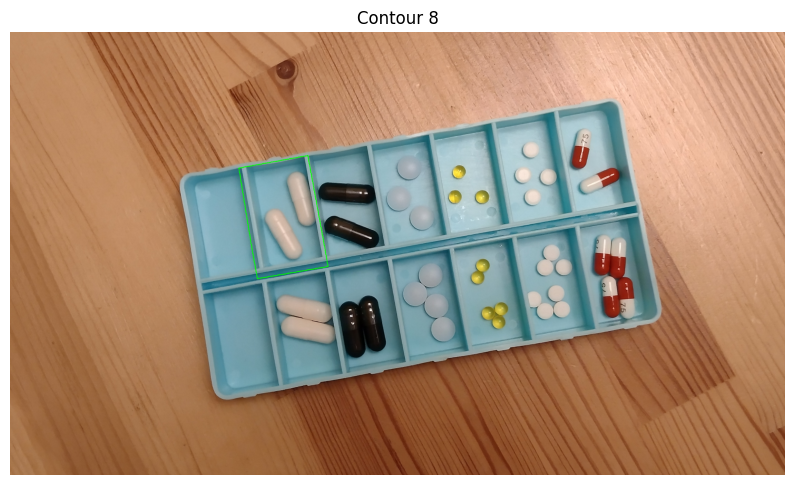

Contour 8 contains:
  PROBIO: 2
  CARBON: 0
  KETO: 0
  ESPU: 0
  BIOX: 0
  LINE: 0


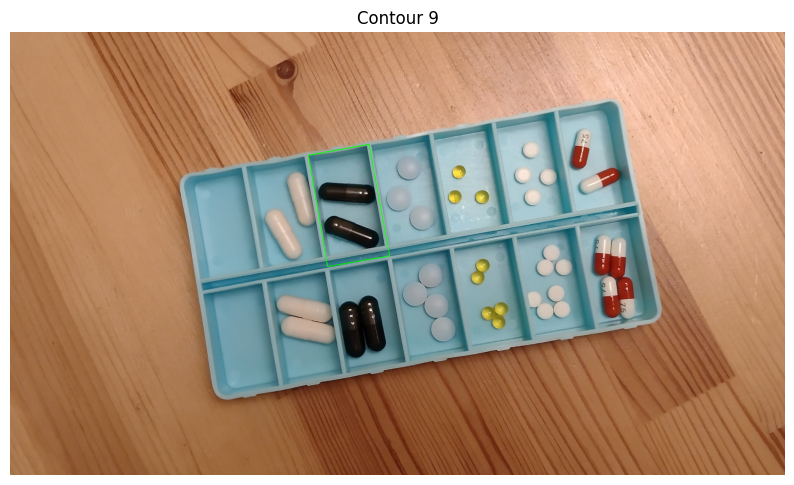

Contour 9 contains:
  PROBIO: 0
  CARBON: 2
  KETO: 0
  ESPU: 0
  BIOX: 0
  LINE: 0


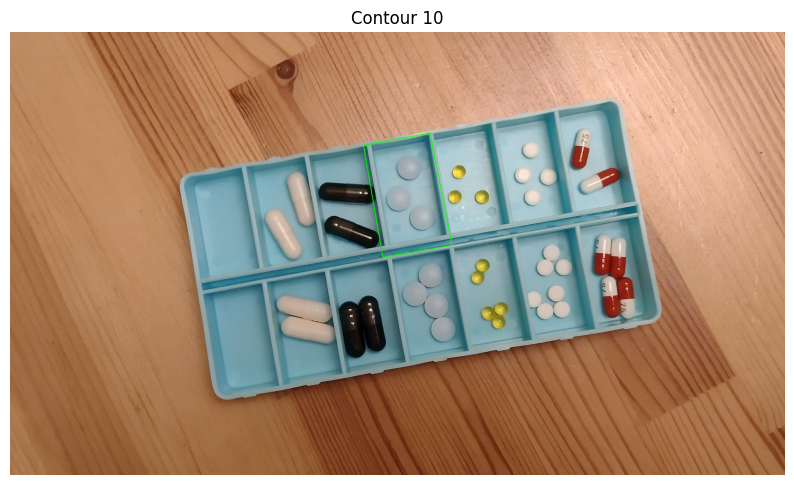

Contour 10 contains:
  PROBIO: 0
  CARBON: 0
  KETO: 3
  ESPU: 0
  BIOX: 0
  LINE: 0


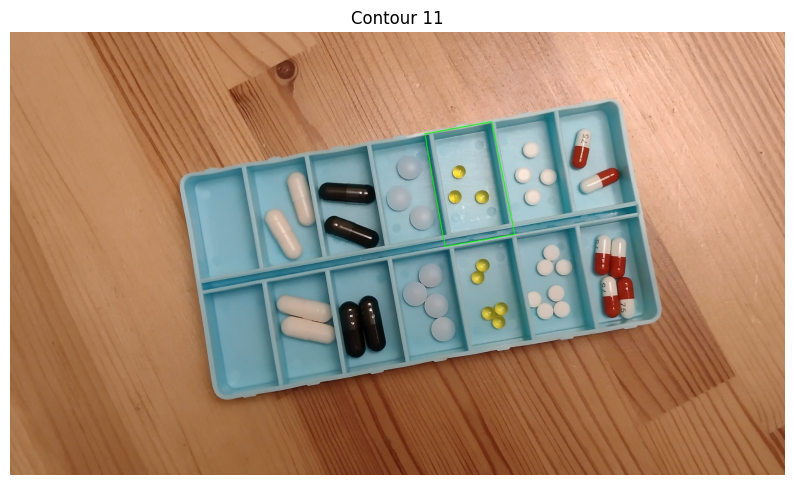

Contour 11 contains:
  PROBIO: 0
  CARBON: 0
  KETO: 0
  ESPU: 3
  BIOX: 0
  LINE: 0


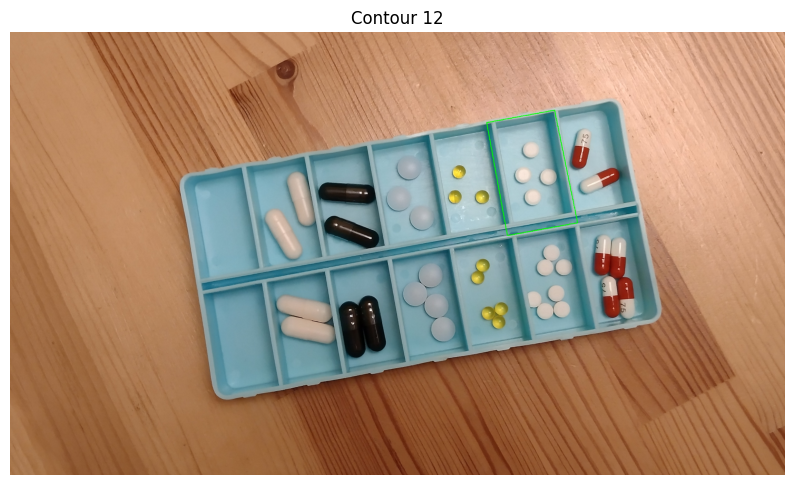

Contour 12 contains:
  PROBIO: 0
  CARBON: 0
  KETO: 0
  ESPU: 0
  BIOX: 4
  LINE: 0


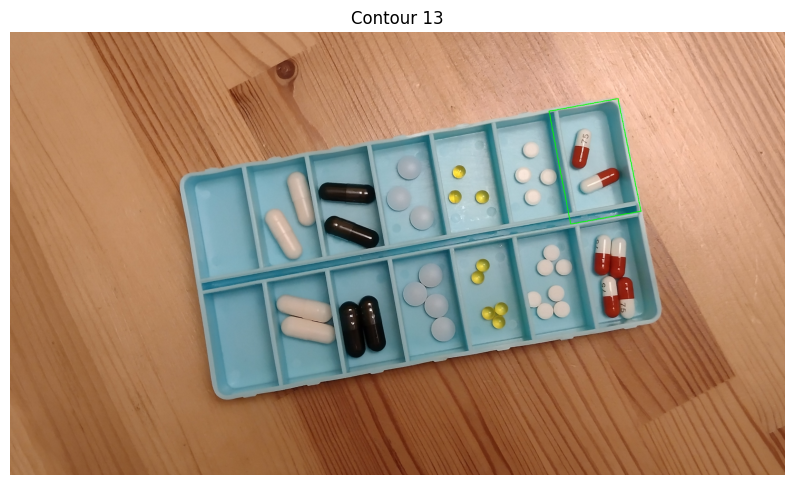

Contour 13 contains:
  PROBIO: 0
  CARBON: 0
  KETO: 0
  ESPU: 0
  BIOX: 0
  LINE: 0


In [27]:
display_pills_in_contours(calib)

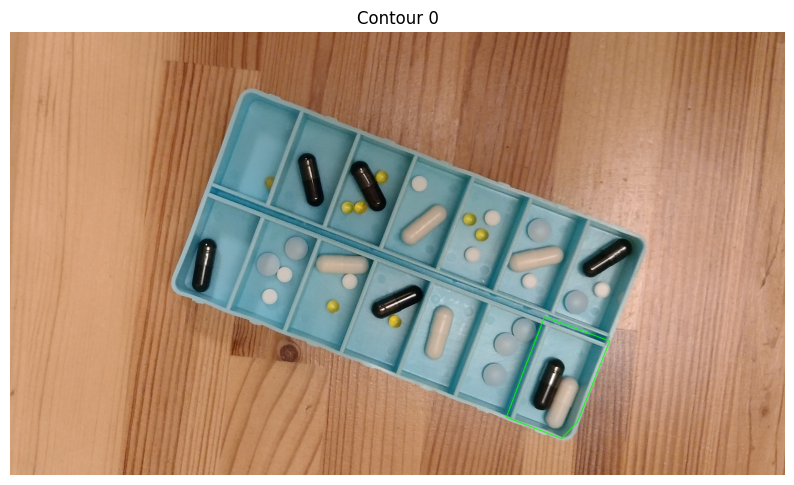

Contour 0 contains:
  PROBIO: 1
  CARBON: 1
  KETO: 0
  ESPU: 0
  BIOX: 0
  LINE: 0


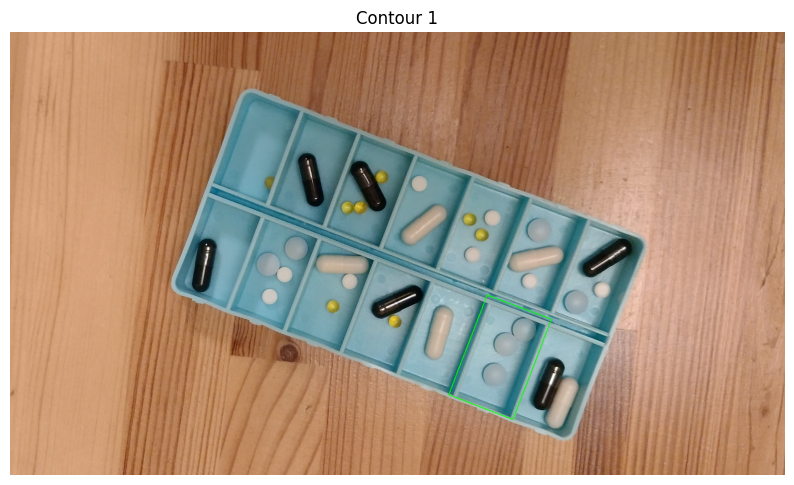

Contour 1 contains:
  PROBIO: 0
  CARBON: 0
  KETO: 3
  ESPU: 0
  BIOX: 0
  LINE: 0


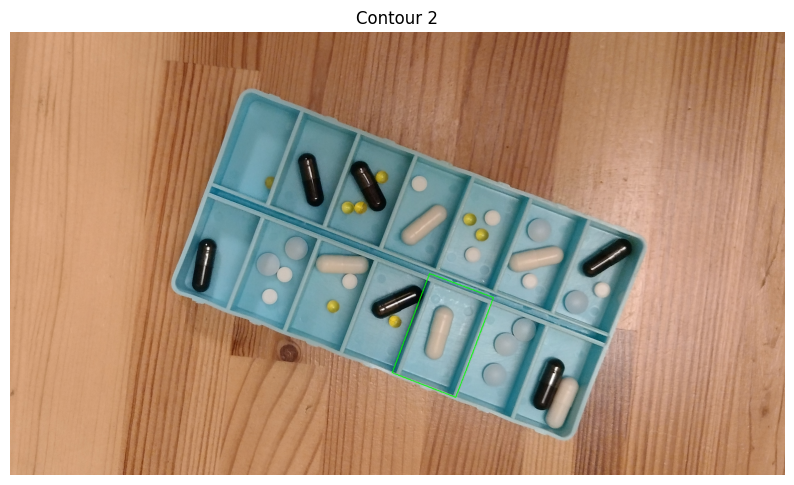

Contour 2 contains:
  PROBIO: 1
  CARBON: 0
  KETO: 0
  ESPU: 0
  BIOX: 0
  LINE: 0


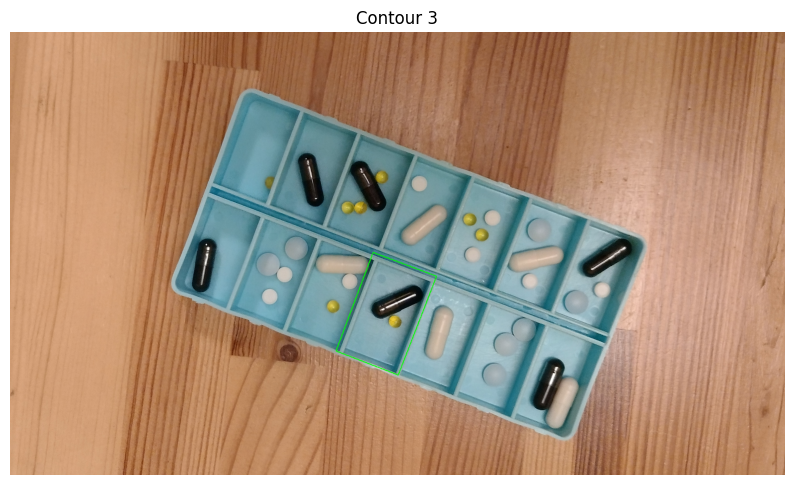

Contour 3 contains:
  PROBIO: 0
  CARBON: 1
  KETO: 0
  ESPU: 1
  BIOX: 0
  LINE: 0


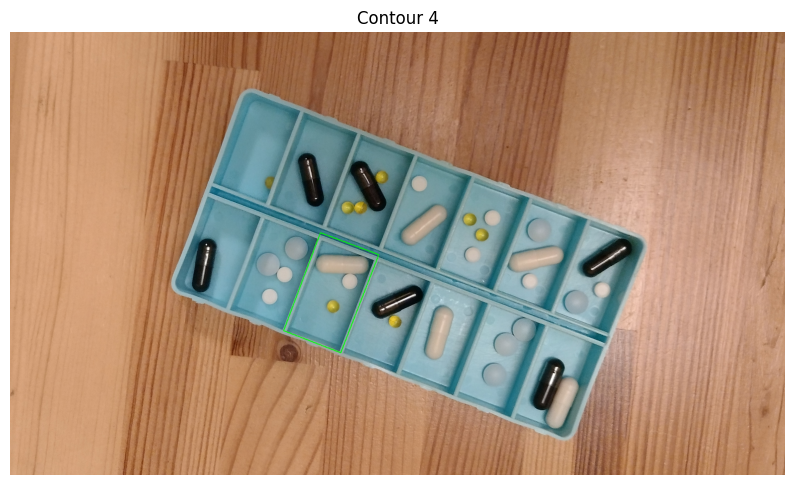

Contour 4 contains:
  PROBIO: 1
  CARBON: 0
  KETO: 0
  ESPU: 1
  BIOX: 1
  LINE: 0


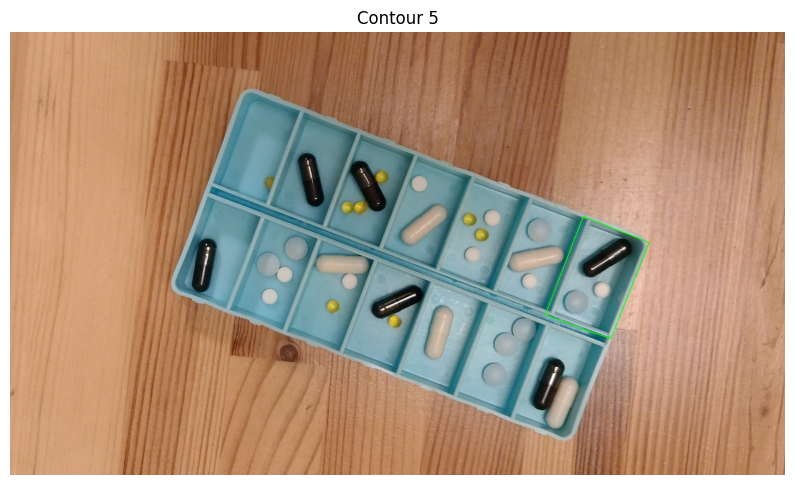

Contour 5 contains:
  PROBIO: 0
  CARBON: 1
  KETO: 1
  ESPU: 0
  BIOX: 1
  LINE: 0


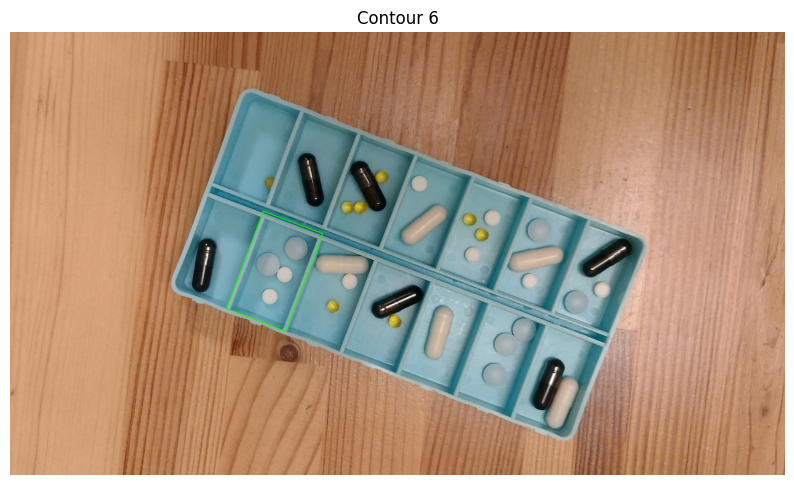

Contour 6 contains:
  PROBIO: 0
  CARBON: 0
  KETO: 2
  ESPU: 0
  BIOX: 2
  LINE: 0


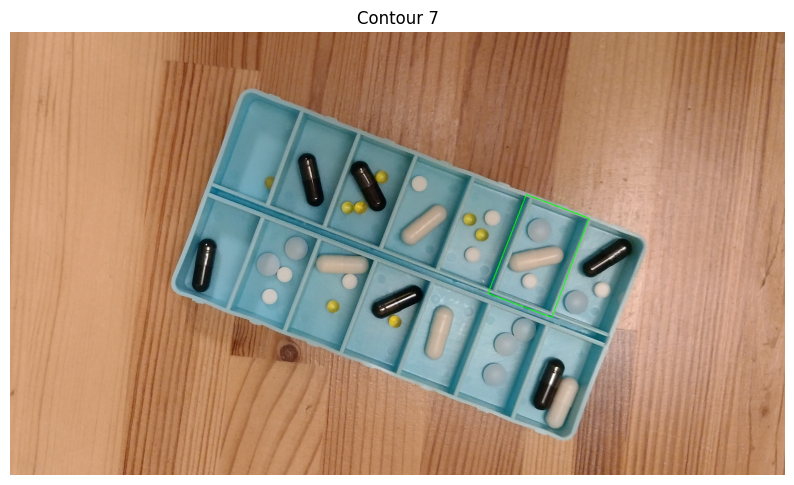

Contour 7 contains:
  PROBIO: 1
  CARBON: 0
  KETO: 1
  ESPU: 0
  BIOX: 1
  LINE: 0


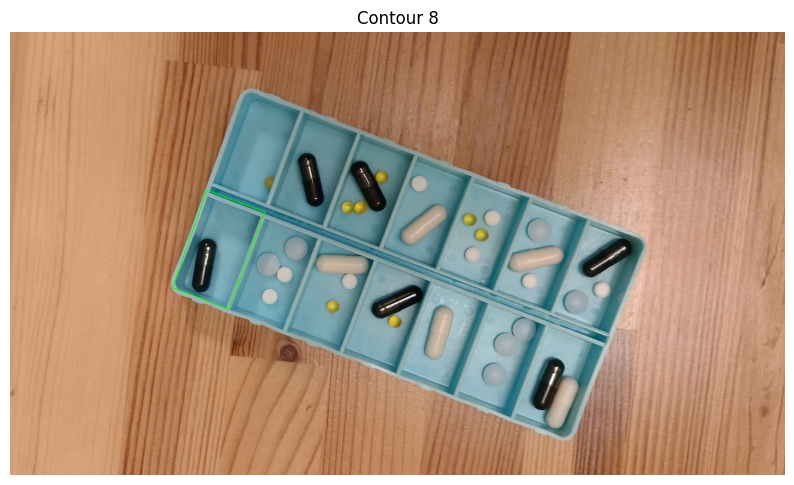

Contour 8 contains:
  PROBIO: 0
  CARBON: 1
  KETO: 0
  ESPU: 0
  BIOX: 0
  LINE: 0


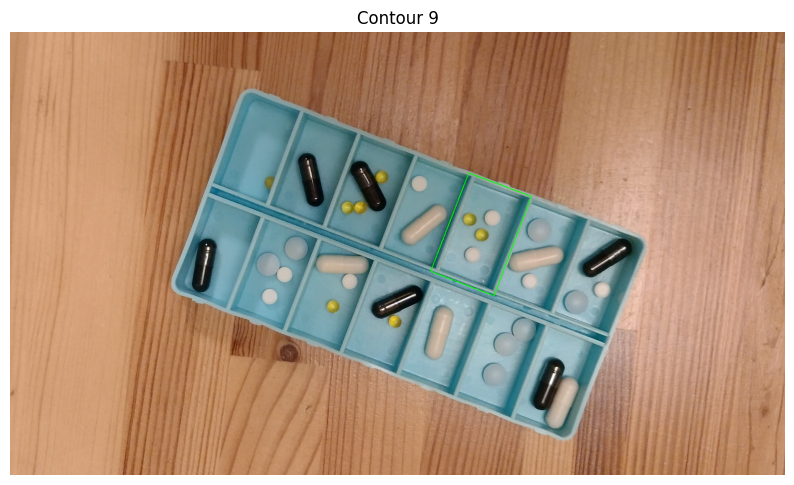

Contour 9 contains:
  PROBIO: 0
  CARBON: 0
  KETO: 0
  ESPU: 2
  BIOX: 2
  LINE: 0


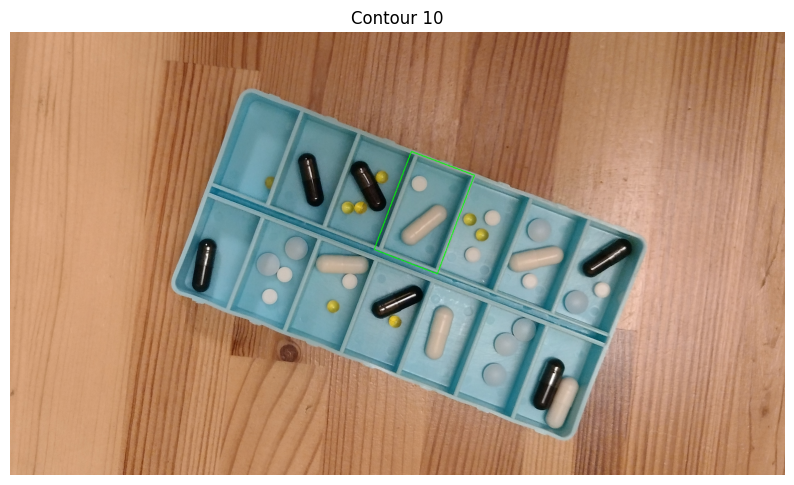

Contour 10 contains:
  PROBIO: 1
  CARBON: 0
  KETO: 0
  ESPU: 0
  BIOX: 1
  LINE: 0


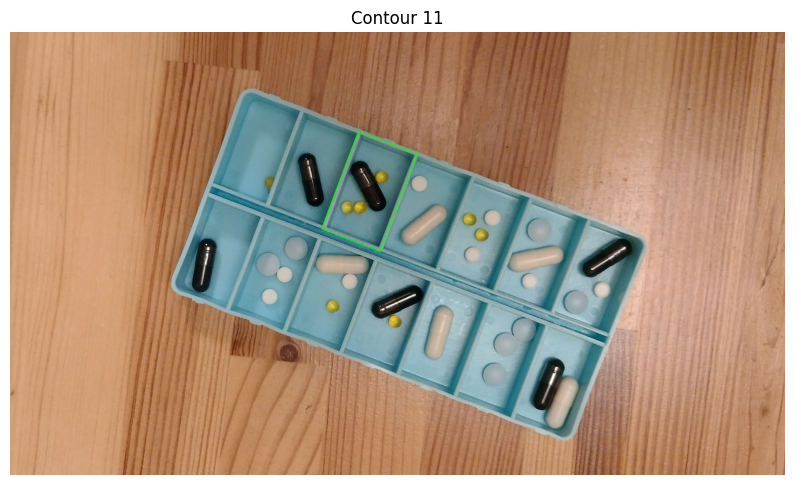

Contour 11 contains:
  PROBIO: 0
  CARBON: 1
  KETO: 0
  ESPU: 3
  BIOX: 0
  LINE: 0


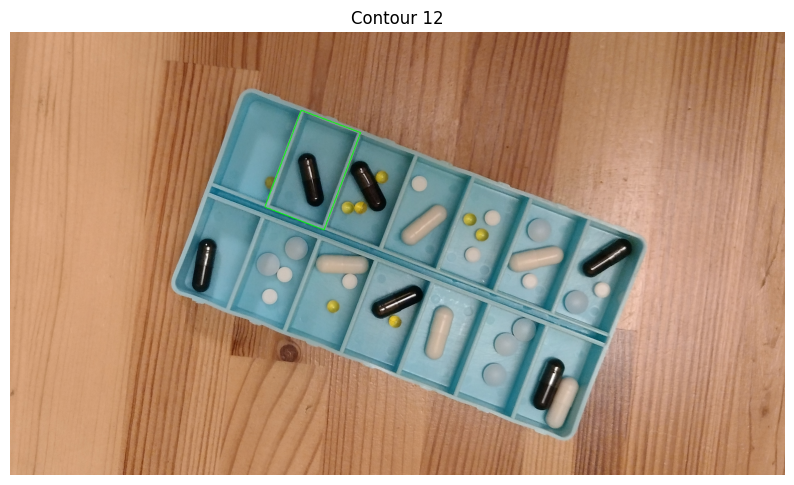

Contour 12 contains:
  PROBIO: 0
  CARBON: 1
  KETO: 0
  ESPU: 0
  BIOX: 0
  LINE: 0


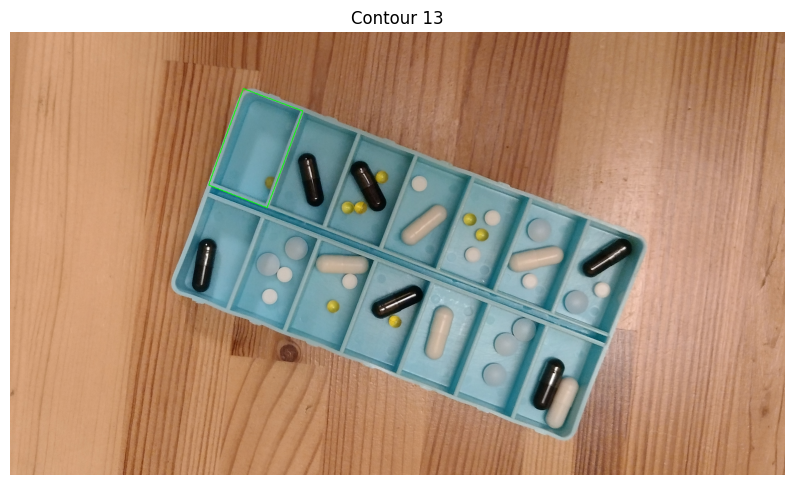

Contour 13 contains:
  PROBIO: 0
  CARBON: 0
  KETO: 0
  ESPU: 1
  BIOX: 0
  LINE: 0


In [28]:
display_pills_in_contours(test)